<a href="https://colab.research.google.com/github/woodychang0611/VisDrone/blob/master/VisDroneData.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [86]:
import sys
import os
from PIL import Image,ImageDraw,ImageFont
import numpy as np
from matplotlib import pyplot as plt
import matplotlib.pyplot as plt
import glob
import pandas as pd

if ('google.colab' in sys.modules):
  from google.colab import drive
  drive.mount('/content/gdrive')
  gdrive_root = 'gdrive/My Drive/Deep_Learning/'
  dataset_path = os.path.join(gdrive_root,'Dataset/visdrone_dl')
  image_path =  os.path.join(dataset_path,'train2017')
  annotation_path = os.path.join(dataset_path,'train2017_ann/annotations')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
#Unzip the dataset
#!tar -zxvf '/content/gdrive/My Drive/Deep_Learning/Dataset/visdrone_dl.tar.gz' -C "/content/gdrive/My Drive/Deep_Learning/Dataset/visdrone_dl"

In [0]:
annotation_dataframe = None
preload_csv =os.path.join(dataset_path,"annotation.csv")
expected_file_count = 6471
expected_region_count = 353550 
if os.path.isfile(preload_csv):
  print (f'{preload_csv} exists')
  annotation_dataframe = pd.read_csv(preload_csv)
  file_conut = annotation_dataframe.file_name.unique().shape[0]
  region_count = annotation_dataframe.shape[0]
  print(f'{region_count} {file_conut} ')
  if (region_count==expected_region_count and file_conut==expected_file_count):
    print("data checked ok")
  else:
    print("data checked nok")
else:
  print (f'{preload_csv} does not exist, read data')
  image_files = glob.glob(f'{image_path}/*.jpg')
  annotation_files = glob.glob(f'{annotation_path}/*.txt')
  print(f'total {len(image_files)} images, {len(annotation_files)} annotations')
  annotation_dataframe = pd.DataFrame()
  col_names =["left","top","width","height","score","category","truncation","occlusion"]
  file_count = len(annotation_files)
  print ("Start reading")
  for idx,file in enumerate(annotation_files[:]):
    df_temp = pd.read_csv(file,header=None,names=col_names)
    df_temp['file_name']= os.path.basename(file).replace("txt","jpg")
    annotation_dataframe = pd.concat([df,df_temp])
    if((idx+1)%100 ==0 or (idx+1) == file_count):
      print(f'\r{idx+1}/{file_count} read, len:{len(df)}', end="")
  annotation_dataframe.to_csv(os.path.join(preload_csv))

gdrive/My Drive/Deep_Learning/Dataset/visdrone_dl/annotation.csv exists
353550 6471 
data checked ok


width


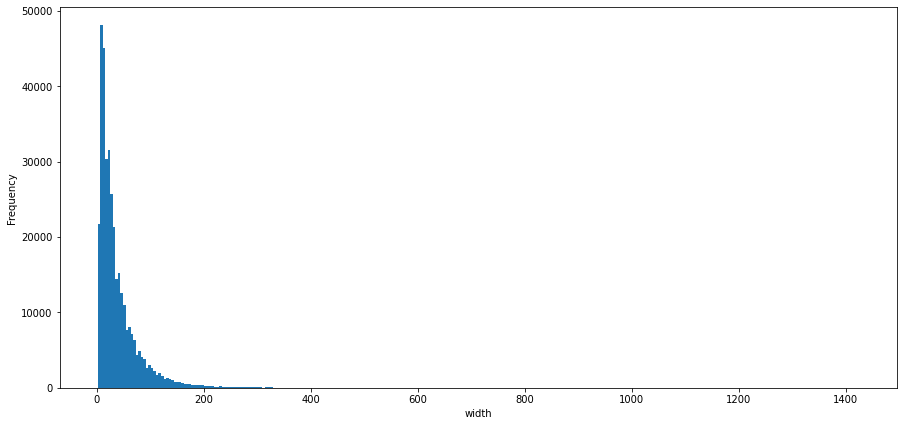

min:2, max:1424, average:39.105297694809785
height


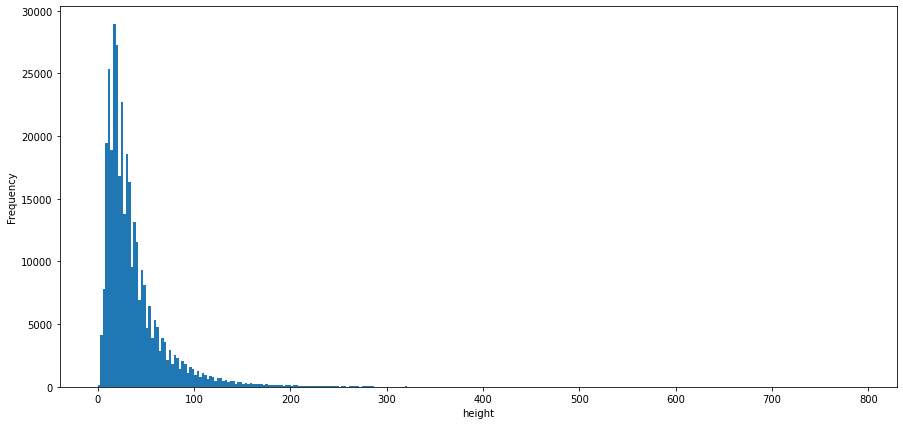

min:0, max:790, average:37.51462593692547
area


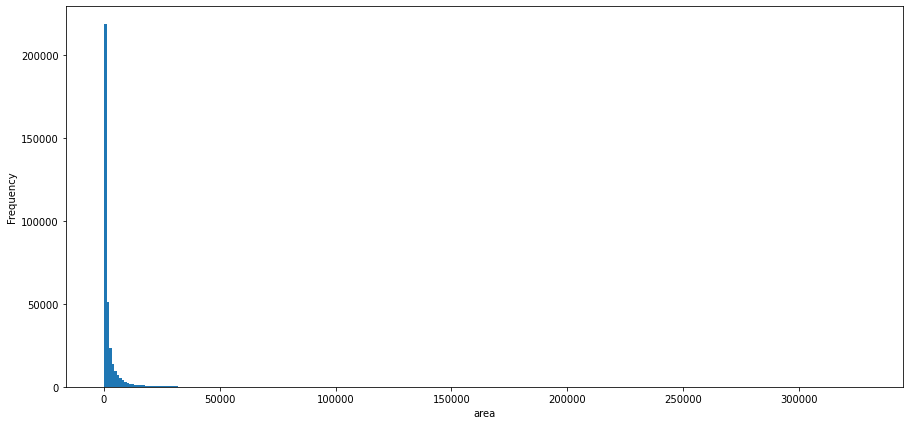

min:0, max:328640, average:2490.1672408428794


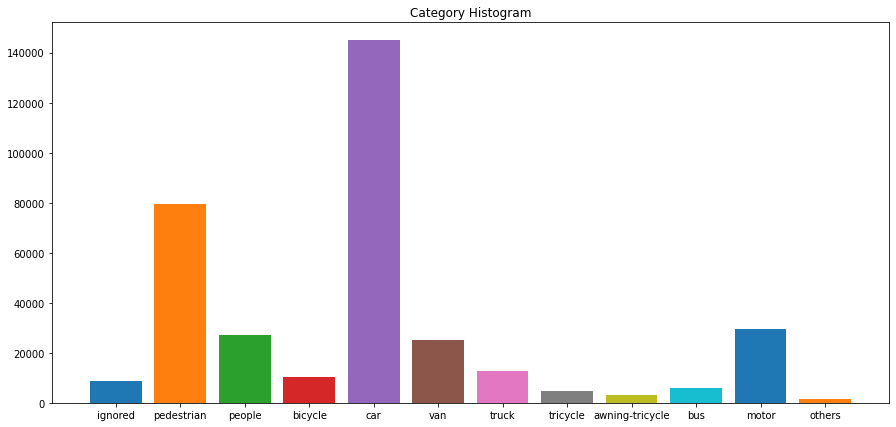

In [107]:
#Calculate Area
annotation_dataframe['area'] = annotation_dataframe.width * annotation_dataframe.height

for col_name in ('width','height','area'):
  print(col_name)
  min = annotation_dataframe[col_name].min()
  max = annotation_dataframe[col_name].max()
  average =  annotation_dataframe[col_name].mean()
  plt.figure(figsize=(15,7))
  plt.hist(annotation_dataframe[col_name],bins=300)
  plt.ylabel('Frequency')
  plt.xlabel(col_name)
  plt.show()
  print(f'min:{min}, max:{max}, average:{average}')

import matplotlib.pyplot as plt
color_cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
class_label = {0:'ignored',1:'pedestrian',2:'people',3:'bicycle',4:'car',5:'van',6:'truck',7:'tricycle',8:'awning-tricycle',9:'bus',10:'motor',11:'others'}
temp = annotation_dataframe.groupby('category').count() 
count=temp.iloc[:,0].tolist()
plt.figure(figsize=(15,7))
plt.title("Category Histogram") 
plt.bar(class_label.values(), count,color=color_cycle)
plt.show()

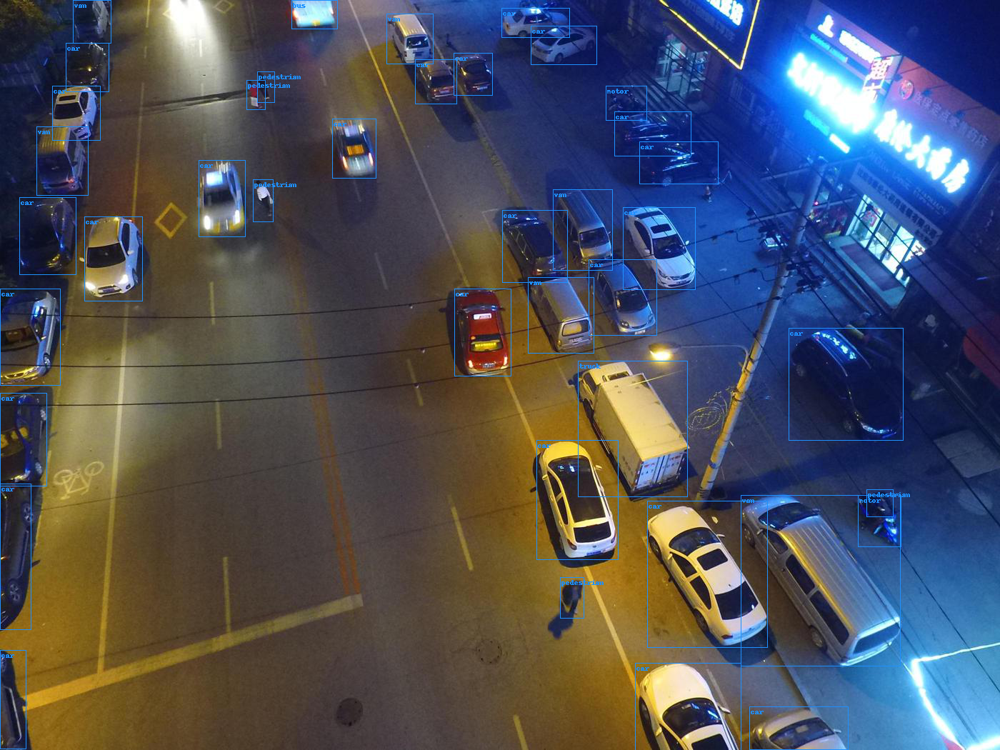

In [139]:
def get_image(path,):
  image = Image.open(os.path.join(image_path,path))
  draw_image = ImageDraw.Draw(image)   
  for left,top,width,height,category in annotation_dataframe[annotation_dataframe['file_name']==path][["left","top","width","height","category"]].values:
    shape = [(left, top), (left+width, top+height)]
    draw_image.rectangle(shape, fill =None, outline ="dodgerblue")
    font = ImageFont.load_default()
    draw_image.text((left+2,top+2), class_label[category],font=font,  fill="dodgerblue")
  return image

sample_file = annotation_dataframe.sample()['file_name'].values[0]
display(get_image(sample_file))

0.05
9999999_00472_d_0000211.jpg
84


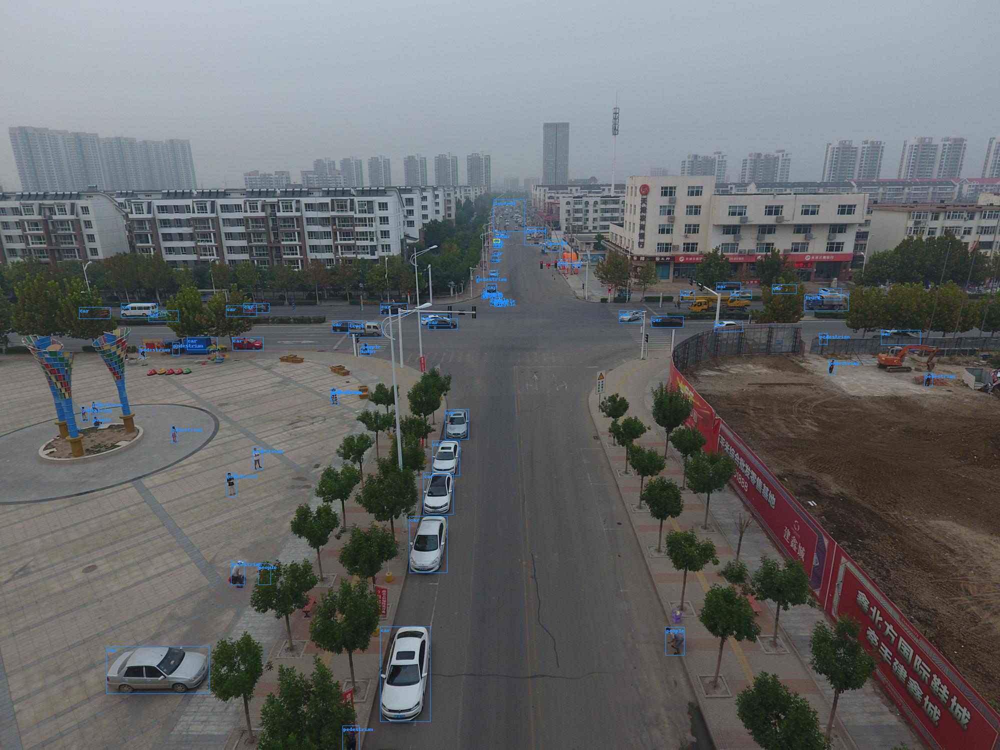

0.1
0000126_02076_d_0000125.jpg
147


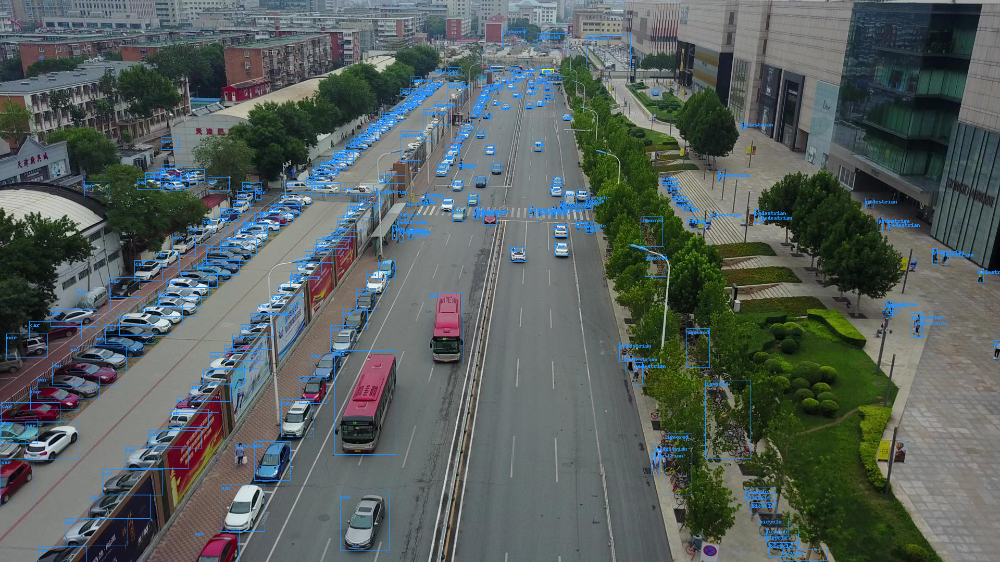

0.5
9999955_00000_d_0000372.jpg
1104


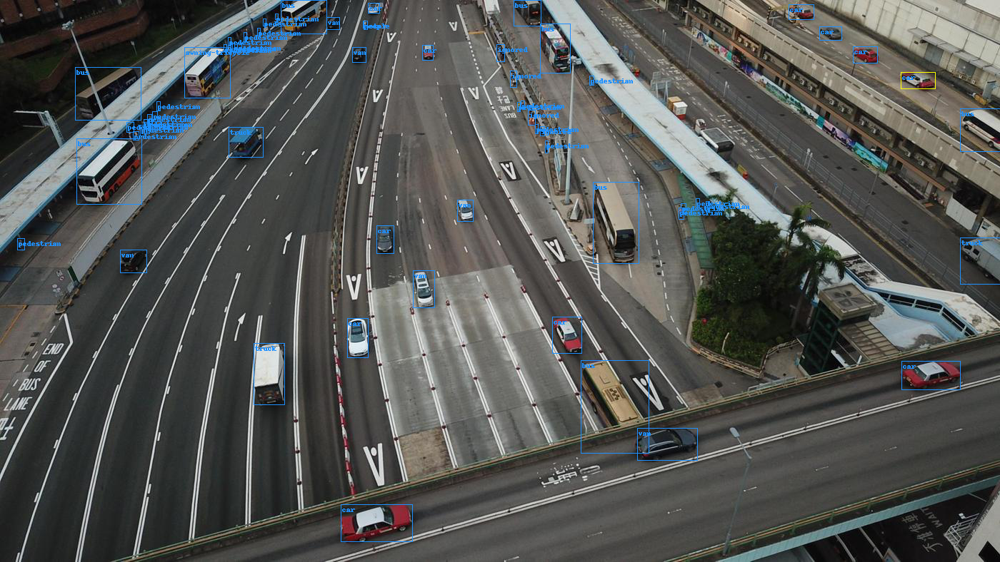

0.9
9999998_00435_d_0000387.jpg
7992


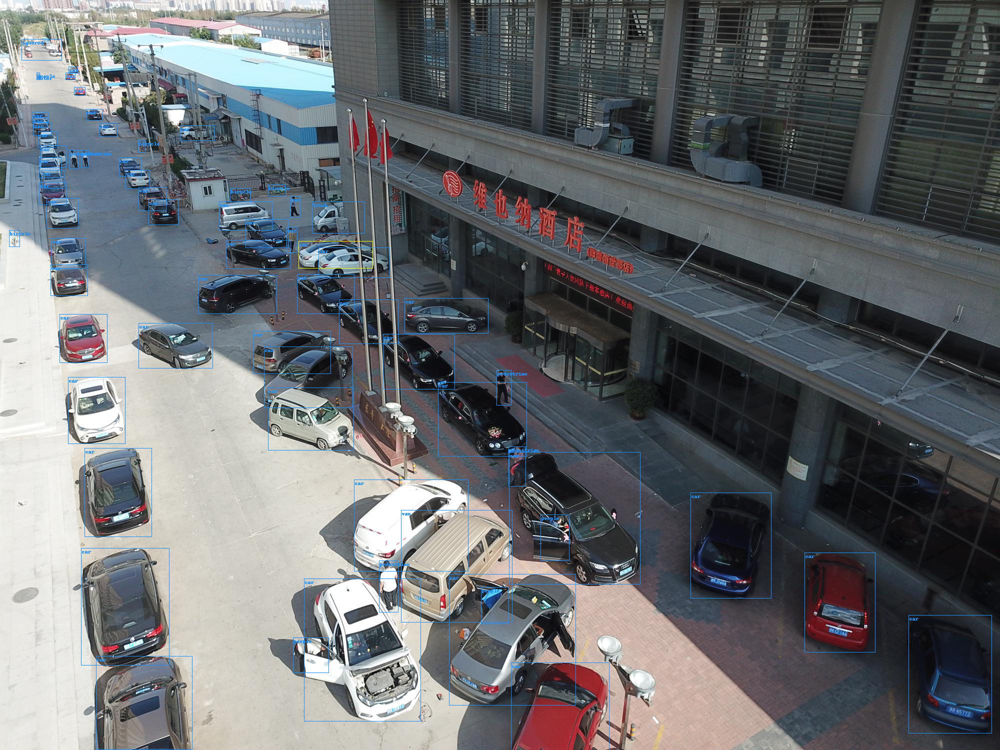

0.95
9999999_00456_d_0000203.jpg
13064


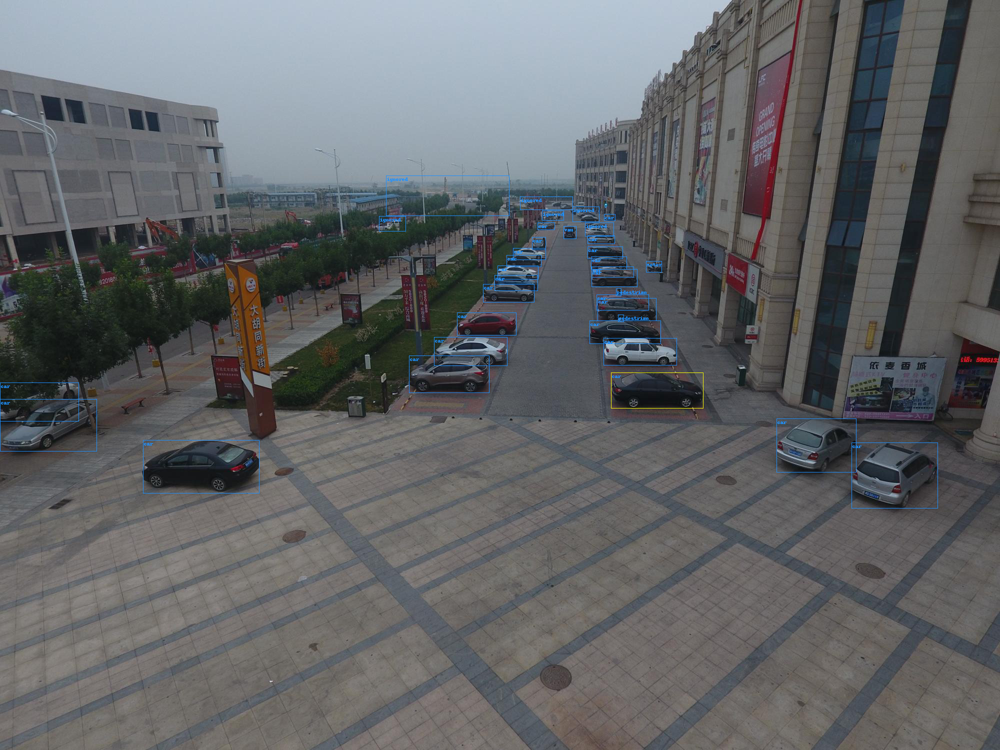

0.999
9999966_00000_d_0000113.jpg
73775


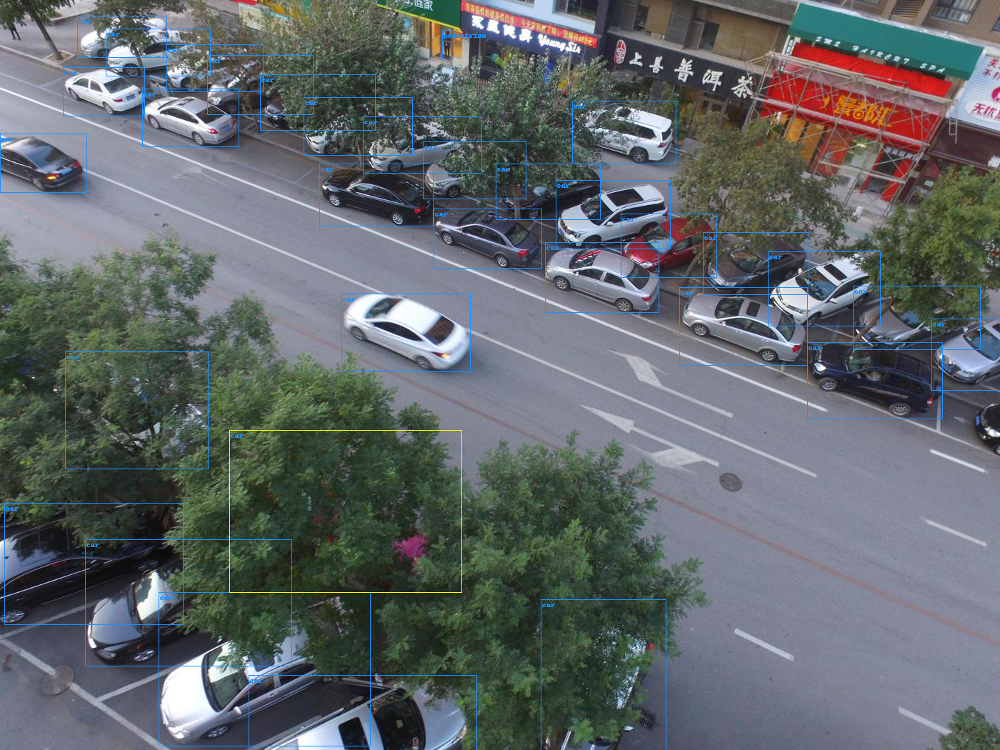

In [145]:
sorted_car_data = annotation_dataframe[annotation_dataframe["category"]==4].sort_values(by=["area"])
count = len(sorted_car_data)
for ratio in (0.05,0.1,0.5,0.9,0.95,0.999):
  print(ratio)
  left,top,width,height,file_name = sorted_car_data.iloc[int(count*ratio)][["left","top","width","height",'file_name']]
  print(file_name)
  print(sorted_car_data.iloc[int(count*ratio)]['area'])
  image = get_image(file_name)
  draw_image = ImageDraw.Draw(image)   
  shape = [(left, top), (left+width, top+height)]
  draw_image.rectangle(shape, fill =None, outline ="yellow")
  display(image)
